<a href="https://colab.research.google.com/github/milqsimmer/IA905a/blob/main/Ex06_261300.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Nome: Camila Maria Serra Quadros

RA: 261300

Curso: Mestrado - Aluno especial

# Ex06 - Desafio de classificação: detecção de tumores no cérebro

O objetivo deste desafio é classificar um conjunto de imagens 2D de cérebros saudáveis e cérebros contendo tumores. As imagens estão no diretório **Dados/Ex06/Brain_Tumor_Dataset**, subdivididas em conjuntos de treino, validação e teste. Note que as labels do conjunto de teste não estão disponíveis!

Sinta-se livre para utilizar qualquer classificador/técnica que desejar, mas lembre-se de justificar suas escolhas! A ideia é que você tente utilizar tudo que foi aprendido até aqui para obter um classificador com o melhor desempenho possível. Após definir o seu modelo final, você deve obter as predições para o conjunto de teste. Assim, além deste notebook com seus experimentos e comentários, você deve enviar também um arquivo com as suas predições para o conjunto de teste. Nas instruções do exercício no classroom você vai encontrar informações mais específicas sobre como enviar suas predições para o conjunto de teste.

**ATENÇÃO**: a nota deste exercício não vai se basear no desempenho final do seu classificador! Mais detalhes sobre os critérios de avaliação serão postados no classroom em breve.

Sugestões:
- Aplique técnicas de data augmentation;
- Tente utilizar modelos pré-treinados e técnicas de transfer learning;
- Tente modificar os hiperparâmetros (Optimizer, Learning-Rate, Número de Épocas, Tamanho do Batch, etc) para obter modelos com melhor desempenho;
- Utilize alguma ferramenta para acompanhamento e visualização das curvas de treino e validação (loss e acurácia). Por ex.: [Neptune](https://neptune.ai) ou [Wandb](https://wandb.ai/). Compare as diferentes versões de modelos utilizadas.

In [62]:
# Seu código aqui

In [2]:
# Instalando bibliotecas no Colab
!pip install pytorch-lightning torchinfo torchmetrics --quiet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 801.9/801.9 kB 7.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 841.5/841.5 kB 11.5 MB/s eta 0:00:00


In [3]:
# Importando as bibliotecas que serão utilizadas
import numpy as np
import matplotlib.pyplot as plt
import os
from glob import glob
import random
import torch
from torch import nn
from torch.utils.data import DataLoader
from torch.optim import AdamW
import pytorch_lightning as pl
from pytorch_lightning.callbacks import ModelCheckpoint
from torchvision import datasets, models
from torchvision.transforms import ToTensor
from torchvision.utils import make_grid
from torchmetrics import Accuracy
import torchinfo
from torchsummary import summary
import multiprocessing as mp
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

%load_ext tensorboard

# Definindo o nome da pasta compartilhada
pasta_compartilhada = "P_IA905A_2024S1"

In [4]:
# Conexão do colab com o drive
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


# Modelo 1

## Carregando e vizualisando as imagens

In [66]:
import torchvision.transforms as transforms
import torchvision.datasets as datasets
from torch.utils.data import DataLoader

# the training transforms
train_transform = transforms.Compose([
    transforms.Grayscale(),
    transforms.ToTensor(),
])
# the validation transforms
valid_transform = transforms.Compose([
    transforms.Grayscale(),
    transforms.ToTensor(),
])

In [67]:
path = f"gdrive/MyDrive/{pasta_compartilhada}/Dados/Ex06/"

# training dataset
train_dataset = datasets.ImageFolder(
    root=path+'Brain_Tumor_Dataset/train',
    transform=train_transform
)
# validation dataset
valid_dataset = datasets.ImageFolder(
    root=path+'Brain_Tumor_Dataset/val',
    transform=valid_transform
)

# checando informações
print('############################################ TRAIN ############################################')
print(train_dataset) # 90 tumor, 53 health
print()
print('############################################ VAL ############################################')
print(valid_dataset) # 41 tumor, 21 health

############################################ TRAIN ############################################
Dataset ImageFolder
    Number of datapoints: 143
    Root location: gdrive/MyDrive/P_IA905A_2024S1/Dados/Ex06/Brain_Tumor_Dataset/train
    StandardTransform
Transform: Compose(
               Grayscale(num_output_channels=1)
               ToTensor()
           )

############################################ VAL ############################################
Dataset ImageFolder
    Number of datapoints: 62
    Root location: gdrive/MyDrive/P_IA905A_2024S1/Dados/Ex06/Brain_Tumor_Dataset/val
    StandardTransform
Transform: Compose(
               Grayscale(num_output_channels=1)
               ToTensor()
           )


2
<class 'torch.Tensor'> <class 'int'>
Shape da imagem: torch.Size([1, 239, 211])
Label: 1
Maior valor de intensidade da imagem: tensor(1.)
Menor valor de intensidade da imagem: tensor(0.)


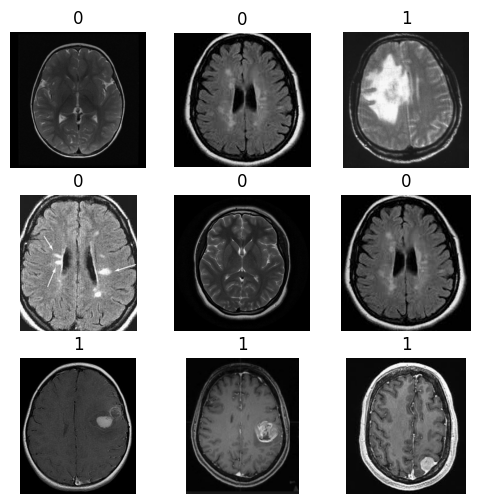

In [68]:
# Checando informações de uma amostra de treinamento
training_example = random.choice(train_dataset)
print(len(training_example))
print(type(training_example[0]), type(training_example[1]))
print('Shape da imagem:', training_example[0].shape)
print('Label:', training_example[1])
print('Maior valor de intensidade da imagem:', torch.max(training_example[0]))
print('Menor valor de intensidade da imagem:', torch.min(training_example[0]))

# Visualizando algumas imagens e labels do conjunto de treinamento
figure = plt.figure(figsize=(6, 6))
cols, rows = 3, 3
for i in range(1, cols * rows + 1):
    img, label = random.choice(train_dataset)
    plt.subplot(rows, cols, i)
    plt.title(label)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray", vmin=0, vmax=1)
plt.show()

As imagens não tem formatos iguais, precisamos entender como lidar com esse problema, já que para utilizar CNN seria ideal ter imagens de mesmo shape.

Referência: https://wandb.ai/ayush-thakur/dl-question-bank/reports/How-to-Handle-Images-of-Different-Sizes-in-a-Convolutional-Neural-Network--VmlldzoyMDk3NzQ


## Tratamento de imagens

In [69]:
# Cropping images that have much black before resizing

In [70]:
# the training transforms
train_transform = transforms.Compose([
    transforms.Resize((224,224)),                     # A maioria dos artigos recomenda imagens 224x224 para Resnet
    transforms.Grayscale(),
    transforms.RandomHorizontalFlip(),                # Data augmentation no conjunto de treino
    transforms.RandomVerticalFlip(),
    transforms.ToTensor(),
    transforms.Normalize([0.5, ], [0.5, ]),           # Normalization helps get data within a range and reduces the skewness which helps learn faster and better
])

# the validation transforms
valid_transform = transforms.Compose([
    transforms.Resize((224,224)),
    transforms.Grayscale(),
    transforms.ToTensor(),
    transforms.Normalize([0.5, ], [0.5, ]),
])

Observei que tem algumas imagens com muito contorno preto, que pode alterar muito o formato da parte de interesse (o cérebro) quando for feito o *resizing*. Então criei uma função para fazer o crop desses contorno (abaixo), mas antes refiz as funções de transformação (acima) para os conjuntos de treino e validação.

Utilizei da técnica de data augmentation para o conjunto de treino, levando em consideração de que estamos trabalhando com um conjunto de dados muitíssimo pequeno o que dificulta a generalização do modelo e pode levar a overfitting. Essa técnica ajuda a enriquecer os conjuntos de dados criando muitas variações dos dados existentes e permite que um modelo encontre atributos mais diversos.

Contudo, em situações reais, é importante verificar com um profissional da saúde se as modificações feitas nos dados são coerentes, nesse caso não será feito uma consulta pois se trata de uma atividade para fins didáticos.

Ref: https://aws.amazon.com/pt/what-is/data-augmentation/#:~:text=Data%20augmentation%20techniques%20help%20enrich,to%20encounter%20more%20diverse%20features.

In [71]:
import cv2
from PIL import Image

def crop_image(img, ds='train'): # usando otsu

  img = img.squeeze().numpy()
  img = img*255
  img = img.astype(np.uint8)
  # print(img.shape)

  thresh = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
  # print(thresh.shape)
  # plt.imshow(thresh, cmap='gray')

  contours,hierarchy = cv2.findContours(thresh,cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
  # print(contours)

  # Get the largest contour based on area
  largest_contour = max(contours, key=cv2.contourArea)
  x,y,w,h = cv2.boundingRect(largest_contour)

  # print(x,y,w,h)
  crop = img[y:y+h,x:x+w]

  # print(crop.shape)

  new_img = Image.fromarray(crop)

  if ds == 'train':
    # print(ds)
    new_img = train_transform(new_img)
  if ds == 'valid':
    # print(ds)
    new_img = valid_transform(new_img)    # Para validação não vamos usar data augmentation na hora da transformação

  # plt.imshow(new_img.squeeze(), cmap='gray')

  return new_img

Para a função de crop, foi utilizado o método de Otsu para identificar os contornos da imagem e em seguida foi separado o maior dos contornos identificado para fazer o crop da imagem nos seus limites externos. Para fazer essa função foram feitos vários testes, sempre plotando e printando dados para verificar se o output estava condizendo com o esperado.

Text(0.5, 1.0, 'Imagem Cortada e Redimensionada')

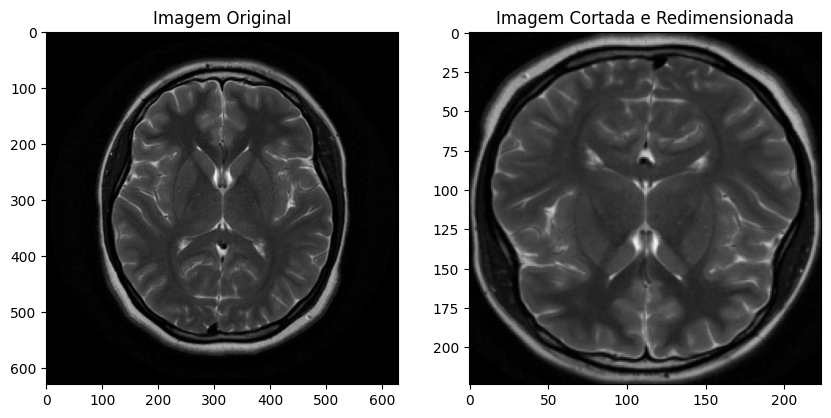

In [72]:
import cv2

# img =  train_dataset[41][0].squeeze().numpy()
img =  train_dataset[0][0]

# print(img.shape)
# print(type(img))

# new_img = crop_image(img)
new_img = crop_image(img)

# print(new_img.shape)
# print(type(new_img))

fig, axs = plt.subplots(1,2, figsize=(10, 6))

plt.subplot(121)
plt.imshow(img.squeeze(), cmap='gray')
plt.title('Imagem Original')

plt.subplot(122)
plt.imshow(new_img.squeeze(), cmap='gray')
plt.title('Imagem Cortada e Redimensionada')

In [73]:
# Aplicando para todas as imagens de treino

In [74]:
crop_train_dataset = []
for i in range(len(train_dataset)):
  img = train_dataset[i][0]
  new_img = crop_image(img)
  crop_train_dataset.append((new_img,train_dataset[i][1]))

2
<class 'torch.Tensor'> <class 'int'>
Shape da imagem: torch.Size([1, 224, 224])
Label: 1
Maior valor de intensidade da imagem: tensor(1.)
Menor valor de intensidade da imagem: tensor(-1.)


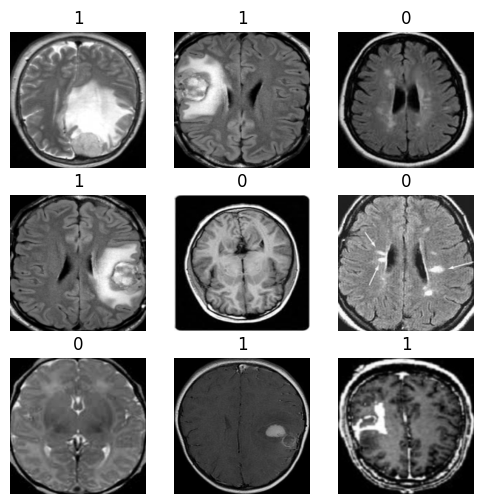

In [75]:
# Checando novo dataset de treino
training_example = random.choice(crop_train_dataset)
print(len(training_example))
print(type(training_example[0]), type(training_example[1]))
print('Shape da imagem:', training_example[0].shape)
print('Label:', training_example[1])
print('Maior valor de intensidade da imagem:', torch.max(training_example[0]))
print('Menor valor de intensidade da imagem:', torch.min(training_example[0]))

# Visualizando algumas imagens e labels do conjunto de treinamento
figure = plt.figure(figsize=(6, 6))
cols, rows = 3, 3
for i in range(1, cols * rows + 1):
    img, label = random.choice(crop_train_dataset)
    plt.subplot(rows, cols, i)
    plt.title(label)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray", vmin=-1, vmax=1)
plt.show()

In [76]:
# Fazer transformações nos dados de validação

In [77]:
crop_valid_dataset = []
for i in range(len(valid_dataset)):
  img = valid_dataset[i][0]
  new_img = crop_image(img, ds='valid')
  crop_valid_dataset.append((new_img,valid_dataset[i][1]))

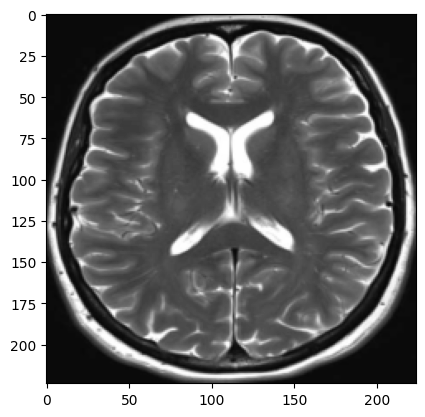

In [78]:
plt.imshow(crop_valid_dataset[0][0].squeeze(), cmap="gray", vmin=-1, vmax=1)

In [79]:
# len(crop_valid_dataset)
# len(crop_train_dataset)

## Treinamento - Exp_Resnet_1

Todos os treinos foram feitos com minha própria CPU pois já não tenho mais acesso a GPU do Colab. Perdi vários treinos que não ficaram salvos e irei por isso apresentar somente os que consegui salvar. Os testes que fiz foram variando principalmente: batch_size, max_epochs e lr (learning rate).

Ref: https://www.javatpoint.com/hyperparameters-in-machine-learning#:~:text=Hyperparameters%20in%20Machine%20learning%20are,learning%20process%20of%20the%20model.

In [80]:
hparams = {"experiment_name": "Exp_ResNet_1",  # experiment name identifies the run for later
           "max_epochs": 50,  # number of epochs to train
           "batch_size": 50,  # size of batch
           "nworkers": mp.cpu_count(),  # number of workers to use in parallel loading
           "nout": 2,  # number of classes
           "nin": 1,  # number of channels of the input image
           "lr": 1e-4,  # learning rate
           "wd": 1e-5,  # weight decay for optimizer
           "cpu": False,  # forces using the CPU
           }

for k, v in hparams.items():
    print(f"{k}: {v}")

experiment_name: Exp_ResNet_1
max_epochs: 50
batch_size: 50
nworkers: 2
nout: 2
nin: 1
lr: 0.0001
wd: 1e-05
cpu: False


In [81]:
class MNISTDataModule(pl.LightningDataModule):
    def __init__(self, hparams):
        super().__init__()
        self.save_hyperparameters(hparams)

    def setup(self, stage=None):
        self.train = crop_train_dataset
        self.val = crop_valid_dataset

    '''
    Dataloaders optimize data loading and automatically prepare batches
    '''
    def train_dataloader(self):
        return DataLoader(self.train, batch_size=self.hparams.batch_size, num_workers=self.hparams.nworkers, shuffle=True)

    def val_dataloader(self):
        return DataLoader(self.val, batch_size=self.hparams.batch_size, num_workers=self.hparams.nworkers, shuffle=False)

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Shape do batch: torch.Size([50, 1, 224, 224])


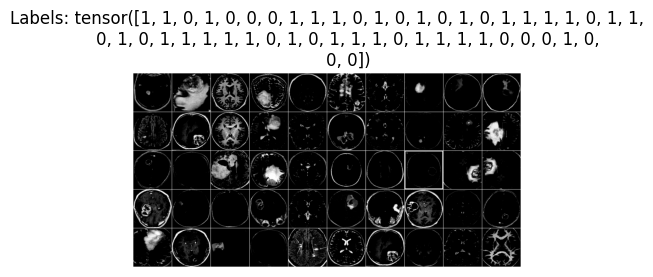

In [82]:
# DEBUG DATA MODULE
data_module = MNISTDataModule(hparams)
data_module.setup()

dataloader = data_module.train_dataloader()
img_batch, label_batch = next(iter(dataloader))
print("Shape do batch:", img_batch.shape)

img_grid = make_grid(img_batch, nrow=10, pad_value=1)
fig = plt.figure(figsize=(5,5))
plt.imshow(img_grid.permute(1, 2, 0).numpy(), vmin=-1, vmax=1) # Aqui não está plotando no range [-1, 1]
plt.title(f'Labels: {label_batch}')
plt.axis('off')
plt.show()

Decidi começar a partir do modelo Resnet18 por ser muito utilizado para classificação de imagens e por já ser familiar para mim.

In [83]:
# Definindo a CNN - Resnet18

cnn_model = models.resnet18(weights=None)
print(cnn_model)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [84]:
# Adaptando primeira e última camada para se adequar aos meus dados de entrada e saída

cnn_model.conv1 = nn.Conv2d(hparams['nin'], 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
num_ftrs = cnn_model.fc.in_features
cnn_model.fc = nn.Linear(num_ftrs, hparams['nout'])
print(cnn_model)

ResNet(
  (conv1): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [85]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)
cnn_model.to(device)
summary(cnn_model, (1, 224, 224))

cpu
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           3,136
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]          36,864
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
             ReLU-10           [-1, 64, 56, 56]               0
       BasicBlock-11           [-1, 64, 56, 56]               0
           Conv2d-12           [-1, 64, 56, 56]          36,864
      BatchNorm2d-13           [-1, 64, 56, 56]             128
             ReLU-14           [-1,

In [86]:
class TrainMNIST(pl.LightningModule):
    def __init__(self, hparams):
        super().__init__()

        self.save_hyperparameters(hparams)
        self.model = cnn_model
        self.loss = nn.CrossEntropyLoss()
        self.accuracy = Accuracy(task="binary", num_classes=self.hparams.nout)

        torchinfo.summary(self.model)

    def forward(self, x):
        return self.model(x).softmax(dim=-1)

    def classification_step(self, mode, batch):
        x, y = batch
        y_hat = self.forward(x)
        loss = self.loss(y_hat, y)

        if mode == "train":
            self.log("loss", loss, on_epoch=True, on_step=True)
            return loss
        elif mode == "val":
            _, preds = torch.max(y_hat, 1)
            self.accuracy(preds, y)
            self.log("val_loss", loss, on_epoch=True, on_step=False, prog_bar=True)
            self.log("val_acc", self.accuracy, on_epoch=True, on_step=False, prog_bar=True)

    def training_step(self, train_batch, batch_idx):
        return self.classification_step("train", train_batch)

    def validation_step(self, val_batch, batch_idx):
        self.classification_step("val", val_batch)

    def configure_optimizers(self):
        optimizer = AdamW(self.model.parameters(), lr=self.hparams.lr, weight_decay=self.hparams.wd)

        return optimizer

In [87]:
debug = False  # Turn this True to test the code with a quick run

# Initialization
model = TrainMNIST(hparams)
data = MNISTDataModule(hparams)

# The PL trainer can run various callbacks during training. Here we only use the
# callback that saves the weights of the trained network.
os.makedirs("logs", exist_ok=True)
checkpoint_callback = [ModelCheckpoint(dirpath="logs",  # path to save checkpoint
                                       filename=hparams["experiment_name"] + "-{epoch}-{val_acc:.2f}",
                                       monitor="val_acc",
                                       mode="max")]

trainer = pl.Trainer(max_epochs=hparams["max_epochs"],
                     fast_dev_run=debug,
                     callbacks=checkpoint_callback,
                     log_every_n_steps=1
                     )

print("Hyperparameters:\n")
for k, v in hparams.items():
    print(f'{k}: {v}')

trainer.fit(model, data)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name     | Type             | Params
----------------------------------------------
0 | model    | ResNet           | 11.2 M
1 | loss     | CrossEntropyLoss | 0     
2 | accuracy | BinaryAccuracy   | 0     
----------------------------------------------
11.2 M    Trainable params
0         Non-trainable params
11.2 M    Total params
44.685    Total estimated model params size (MB)


Hyperparameters:

experiment_name: Exp_ResNet_1
max_epochs: 50
batch_size: 50
nworkers: 2
nout: 2
nin: 1
lr: 0.0001
wd: 1e-05
cpu: False


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=50` reached.


Para analisar os diferentes experimentos, tentei utilizar o Netuno, mas me deparei com algums problemas que não consegui resolver em tempo hábil, então decidi seguir avaliando e comparando os modelos com o TensorBoard, visto que já tinha experiência com o mesmo e precisava dedicar mais tempo aos experimentos de fato.

In [88]:
path = f"lightning_logs"
%tensorboard --logdir {path}

Reusing TensorBoard on port 6006 (pid 30838), started 1:12:20 ago. (Use '!kill 30838' to kill it.)

<IPython.core.display.Javascript object>

Mudando os parâmetros observei que epoch > 50 não estava melhorando os modelos, então não aumentei além disso.

Testei learning rating de 0.0001 e de 0.001 e bach_size de 10, 25, 50 e 100.

In [90]:
# Escolhendo o callback com maior acurácia para mostrar os resultados

baseline_model = f"/content/logs/Exp_ResNet_1-epoch=15-val_acc=0.71.ckpt"
print(f"Using model {baseline_model}")

# Load trained model
model = TrainMNIST.load_from_checkpoint(baseline_model).eval()

# Initialize validation data
data = MNISTDataModule(hparams)
data.setup()
data.hparams.batch_size = 1
val_data = data.val_dataloader()

def collect_2d_results(data, model):
    y_trues = []
    y_labels = []
    for (img, label) in data:
        with torch.no_grad():
            out = model(img).argmax(dim=-1).item()

        label = label.numpy()
        y_trues.append(label)
        y_labels.append(out)

    return y_trues, y_labels

y_trues_val, y_labels_val = collect_2d_results(val_data, model)

Using model /content/logs/Exp_ResNet_1-epoch=15-val_acc=0.71.ckpt


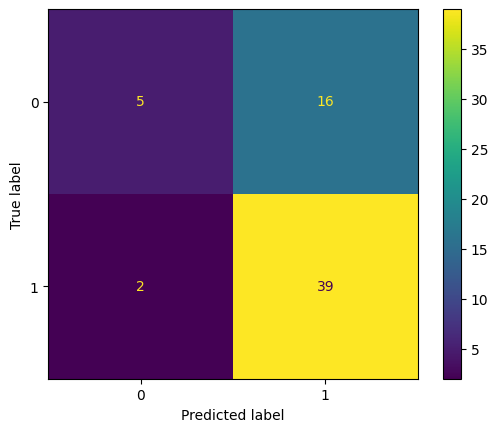

In [91]:
# Confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_trues_val, y_labels_val, labels=np.arange(2)),
                                display_labels=np.arange(2))
fig = disp.plot(ax=None).figure_
plt.show()

In [92]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Validação
acc = accuracy_score(y_trues_val, y_labels_val)
prec = precision_score(y_trues_val, y_labels_val)
rec = recall_score(y_trues_val, y_labels_val)
f1 = f1_score(y_trues_val, y_labels_val)

# Imprimindo as métricas
print('Acurácia: %.2f' % acc)
print('Precisão: %.2f' % prec)
print('Recall: %.2f' % rec)
print('F1-Score: %.2f' % f1)

Acurácia: 0.71
Precisão: 0.71
Recall: 0.95
F1-Score: 0.81


Os modelos tiveram poucos falsos negativos, o que é bom considerando que estamos lidando com dados de saúde. Contudo, o valor de falsos positivos foi bastante relevante e tentarei diminuir esse valor nos modelos a seguir.

# Modelo 2

Para esse modelo, mudei somente os dados de entrada, mantendo os hiperparâmetros. Tentei balancear um pouco o dataset criando dados da classe com menos amostras, a partir das imagens reais. Adicionei mais 40 imagens com label 0 ao dataset de treino. Lembrando que é necessário validar com um profissional que entenda das imagens de MRI.

In [93]:
# Over-sampling

In [94]:
# https://www.kaggle.com/code/rafjaa/dealing-with-very-small-datasets

In [95]:
from numpy import expand_dims
from keras.preprocessing.image import ImageDataGenerator

''' tentar criar mais 40 imagens da label 0 para balancear os dados '''

# the training transforms
aug_transform = transforms.Compose([
  transforms.RandomHorizontalFlip(p=0.5),
  transforms.RandomVerticalFlip(p=0.5),
  # transforms.RandomRotation(degrees=(90, 180)),
])

new_data = []

count = 0
i = 0

while count < 40:
  data_sample = random.choice(crop_train_dataset)
  if data_sample[1] == 0:
    img = torch.clone(data_sample[0])
    lbl = data_sample[1]
    new_img = aug_transform(img)
    count +=1
    new_data.append([new_img, lbl])
  i +=1

2
<class 'torch.Tensor'> <class 'int'>
Shape da imagem: torch.Size([1, 224, 224])
Label: 0
Maior valor de intensidade da imagem: tensor(1.)
Menor valor de intensidade da imagem: tensor(-1.)


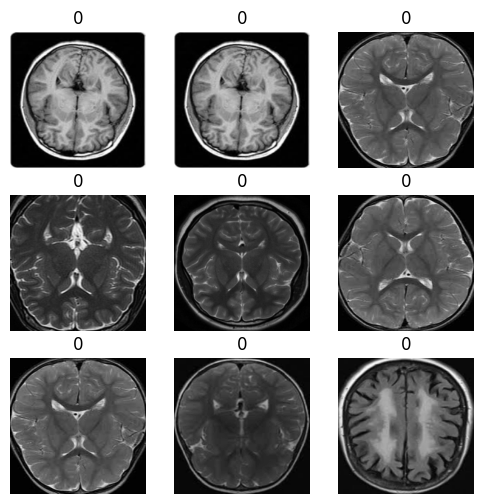

In [96]:
# Checando informações de novas amostras
training_example = random.choice(new_data)
print(len(training_example))
print(type(training_example[0]), type(training_example[1]))
print('Shape da imagem:', training_example[0].shape)
print('Label:', training_example[1])
print('Maior valor de intensidade da imagem:', torch.max(training_example[0]))
print('Menor valor de intensidade da imagem:', torch.min(training_example[0]))

# Visualizando algumas imagens e labels do conjunto de treinamento
figure = plt.figure(figsize=(6, 6))
cols, rows = 3, 3
for i in range(1, cols * rows + 1):
    img, label = random.choice(new_data)
    plt.subplot(rows, cols, i)
    plt.title(label)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray", vmin=-1, vmax=1)
plt.show()

In [97]:
new_data_train = crop_train_dataset + new_data # unindo os datos originais com dados criados
np.random.shuffle(new_data_train) # usando shuffle para embaralhar os dados criados com os originais

In [98]:
# len(crop_valid_dataset) # mantive o mesmo
len(new_data_train) # novo número de amostras de treino

183

In [99]:
hparams = {"experiment_name": "Exp_ResNet_2",  # experiment name identifies the run for later
           "max_epochs": 50,  # number of epochs to train
           "batch_size": 50,  # size of batch
           "nworkers": mp.cpu_count(),  # number of workers to use in parallel loading
           "nout": 2,  # number of classes
           "nin": 1,  # number of channels of the input image
           "lr": 1e-4,  # learning rate
           "wd": 1e-5,  # weight decay for optimizer
           "cpu": False,  # forces using the CPU
           }

for k, v in hparams.items():
    print(f"{k}: {v}")

experiment_name: Exp_ResNet_2
max_epochs: 50
batch_size: 50
nworkers: 2
nout: 2
nin: 1
lr: 0.0001
wd: 1e-05
cpu: False


In [100]:
class MNISTDataModule(pl.LightningDataModule):
    def __init__(self, hparams):
        super().__init__()
        self.save_hyperparameters(hparams)

    def setup(self, stage=None):
        self.train = new_data_train
        self.val = crop_valid_dataset

    '''
    Dataloaders optimize data loading and automatically prepare batches
    '''
    def train_dataloader(self):
        return DataLoader(self.train, batch_size=self.hparams.batch_size, num_workers=self.hparams.nworkers, shuffle=True)

    def val_dataloader(self):
        return DataLoader(self.val, batch_size=self.hparams.batch_size, num_workers=self.hparams.nworkers, shuffle=False)

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Shape do batch: torch.Size([50, 1, 224, 224])


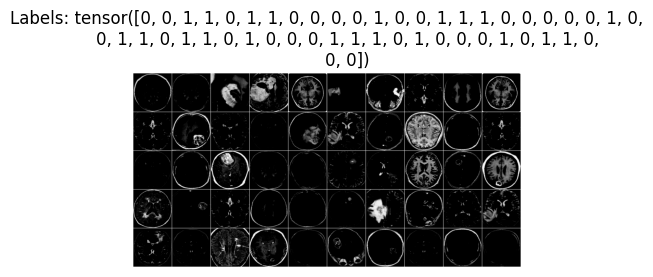

In [101]:
# DEBUG DATA MODULE
data_module = MNISTDataModule(hparams)
data_module.setup()

dataloader = data_module.train_dataloader()
img_batch, label_batch = next(iter(dataloader))
print("Shape do batch:", img_batch.shape)

img_grid = make_grid(img_batch, nrow=10, pad_value=1)
fig = plt.figure(figsize=(5,5))
plt.imshow(img_grid.permute(1, 2, 0).numpy(), vmin=-1, vmax=1)
plt.title(f'Labels: {label_batch}')
plt.axis('off')
plt.show()

In [102]:
# Definindo a CNN

cnn_model_2 = models.resnet18(weights=None)
print(cnn_model_2)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [103]:
cnn_model_2.conv1 = nn.Conv2d(hparams['nin'], 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
num_ftrs = cnn_model_2.fc.in_features
cnn_model_2.fc = nn.Linear(num_ftrs, hparams['nout'])
print(cnn_model_2)

ResNet(
  (conv1): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [104]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)
cnn_model_2.to(device)
summary(cnn_model_2, (1, 224, 224))

cpu
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           3,136
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]          36,864
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
             ReLU-10           [-1, 64, 56, 56]               0
       BasicBlock-11           [-1, 64, 56, 56]               0
           Conv2d-12           [-1, 64, 56, 56]          36,864
      BatchNorm2d-13           [-1, 64, 56, 56]             128
             ReLU-14           [-1,

In [105]:
class TrainMNIST(pl.LightningModule):
    def __init__(self, hparams):
        super().__init__()

        self.save_hyperparameters(hparams)
        self.model = cnn_model_2
        self.loss = nn.CrossEntropyLoss()
        self.accuracy = Accuracy(task="binary", num_classes=self.hparams.nout)

        torchinfo.summary(self.model)

    def forward(self, x):
        return self.model(x).softmax(dim=-1)

    def classification_step(self, mode, batch):
        x, y = batch
        y_hat = self.forward(x)
        loss = self.loss(y_hat, y)

        if mode == "train":
            self.log("loss", loss, on_epoch=True, on_step=True)
            return loss
        elif mode == "val":
            _, preds = torch.max(y_hat, 1)
            self.accuracy(preds, y)
            self.log("val_loss", loss, on_epoch=True, on_step=False, prog_bar=True)
            self.log("val_acc", self.accuracy, on_epoch=True, on_step=False, prog_bar=True)

    def training_step(self, train_batch, batch_idx):
        return self.classification_step("train", train_batch)

    def validation_step(self, val_batch, batch_idx):
        self.classification_step("val", val_batch)

    def configure_optimizers(self):
        optimizer = AdamW(self.model.parameters(), lr=self.hparams.lr, weight_decay=self.hparams.wd)

        return optimizer

In [106]:
debug = False  # Turn this True to test the code with a quick run

# Initialization
model = TrainMNIST(hparams)
data = MNISTDataModule(hparams)

# The PL trainer can run various callbacks during training. Here we only use the
# callback that saves the weights of the trained network.
os.makedirs("logs", exist_ok=True)
checkpoint_callback = [ModelCheckpoint(dirpath="logs",  # path to save checkpoint
                                       filename=hparams["experiment_name"] + "-{epoch}-{val_acc:.2f}",
                                       monitor="val_acc",
                                       mode="max")]

trainer = pl.Trainer(max_epochs=hparams["max_epochs"],
                     fast_dev_run=debug,
                     callbacks=checkpoint_callback,
                     log_every_n_steps=1
                     )

print("Hyperparameters:\n")
for k, v in hparams.items():
    print(f'{k}: {v}')

trainer.fit(model, data)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:653: Checkpoint directory /content/logs exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name     | Type             | Params
----------------------------------------------
0 | model    | ResNet           | 11.2 M
1 | loss     | CrossEntropyLoss | 0     
2 | accuracy | BinaryAccuracy   | 0     
----------------------------------------------
11.2 M    Trainable params
0         Non-trainable params
11.2 M    Total params
44.685    Total estimated model params size (MB)


Hyperparameters:

experiment_name: Exp_ResNet_2
max_epochs: 50
batch_size: 50
nworkers: 2
nout: 2
nin: 1
lr: 0.0001
wd: 1e-05
cpu: False


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=50` reached.


In [107]:
path = f"lightning_logs"
%tensorboard --logdir {path}

Reusing TensorBoard on port 6006 (pid 30838), started 2:07:32 ago. (Use '!kill 30838' to kill it.)

<IPython.core.display.Javascript object>

In [110]:
baseline_model = f"/content/logs/Exp_ResNet_2-epoch=19-val_acc=0.74.ckpt"
print(f"Using model {baseline_model}")

# Load trained model
model = TrainMNIST.load_from_checkpoint(baseline_model).eval()

# Initialize validation data
data = MNISTDataModule(hparams)
data.setup()
data.hparams.batch_size = 1
val_data = data.val_dataloader()

def collect_2d_results(data, model):
    y_trues = []
    y_labels = []
    for (img, label) in data:
        with torch.no_grad():
            out = model(img).argmax(dim=-1).item()

        label = label.numpy()
        y_trues.append(label)
        y_labels.append(out)

    return y_trues, y_labels

y_trues_val, y_labels_val = collect_2d_results(val_data, model)

Using model /content/logs/Exp_ResNet_2-epoch=19-val_acc=0.74.ckpt


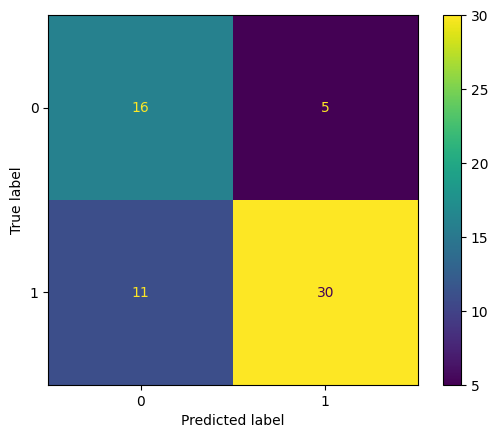

In [111]:
# Confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_trues_val, y_labels_val, labels=np.arange(2)),
                                display_labels=np.arange(2))
fig = disp.plot(ax=None).figure_
plt.show()

In [112]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Validação
acc = accuracy_score(y_trues_val, y_labels_val)
prec = precision_score(y_trues_val, y_labels_val)
rec = recall_score(y_trues_val, y_labels_val)
f1 = f1_score(y_trues_val, y_labels_val)

# Imprimindo as métricas
print('Acurácia: %.2f' % acc)
print('Precisão: %.2f' % prec)
print('Recall: %.2f' % rec)
print('F1-Score: %.2f' % f1)

Acurácia: 0.74
Precisão: 0.86
Recall: 0.73
F1-Score: 0.79


Melhorou um pouco a Acurácia e a Precisão, mas piorou o Recall, o que não é interessante para nosso estudo.

# Modelo 3

In [113]:
# Resnet50

Para o modelo 3 utilizei as imagens sem dados falsos adicionados, ou seja, as mesmas do modelo 1, e alterei o modelo para Resnet50.

In [114]:
hparams = {"experiment_name": "Exp_ResNet_3",  # experiment name identifies the run for later
           "max_epochs": 50,  # number of epochs to train
           "batch_size": 50,  # size of batch
           "nworkers": mp.cpu_count(),  # number of workers to use in parallel loading
           "nout": 2,  # number of classes
           "nin": 1,  # number of channels of the input image
           "lr": 1e-4,  # learning rate
           "wd": 1e-5,  # weight decay for optimizer
           "cpu": False,  # forces using the CPU
           }

for k, v in hparams.items():
    print(f"{k}: {v}")

experiment_name: Exp_ResNet_3
max_epochs: 50
batch_size: 50
nworkers: 2
nout: 2
nin: 1
lr: 0.0001
wd: 1e-05
cpu: False


In [115]:
class MNISTDataModule(pl.LightningDataModule):
    def __init__(self, hparams):
        super().__init__()
        self.save_hyperparameters(hparams)

    def setup(self, stage=None):
        self.train = crop_train_dataset
        self.val = crop_valid_dataset

    '''
    Dataloaders optimize data loading and automatically prepare batches
    '''
    def train_dataloader(self):
        return DataLoader(self.train, batch_size=self.hparams.batch_size, num_workers=self.hparams.nworkers, shuffle=True)

    def val_dataloader(self):
        return DataLoader(self.val, batch_size=self.hparams.batch_size, num_workers=self.hparams.nworkers, shuffle=False)

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Shape do batch: torch.Size([50, 1, 224, 224])


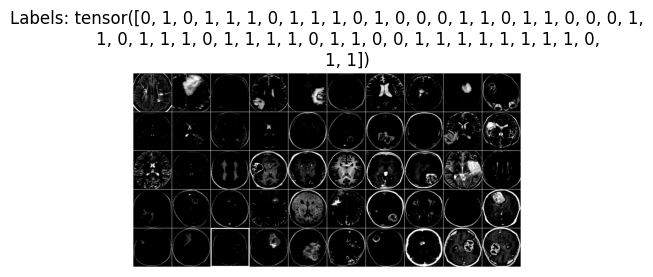

In [116]:
# DEBUG DATA MODULE
data_module = MNISTDataModule(hparams)
data_module.setup()

dataloader = data_module.train_dataloader()
img_batch, label_batch = next(iter(dataloader))
print("Shape do batch:", img_batch.shape)

img_grid = make_grid(img_batch, nrow=10, pad_value=1)
fig = plt.figure(figsize=(5,5))
plt.imshow(img_grid.permute(1, 2, 0).numpy(), vmin=-1, vmax=1)
plt.title(f'Labels: {label_batch}')
plt.axis('off')
plt.show()

In [117]:
# Definindo a CNN

cnn_model_3 = models.resnet50(weights=None)
print(cnn_model_3)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [118]:
cnn_model_3.conv1 = nn.Conv2d(hparams['nin'], 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
num_ftrs = cnn_model_3.fc.in_features
cnn_model_3.fc = nn.Linear(num_ftrs, hparams['nout'])
print(cnn_model_3)

ResNet(
  (conv1): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [119]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)
cnn_model_3.to(device)
summary(cnn_model_3, (1, 224, 224))

cpu
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           3,136
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]           4,096
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
             ReLU-10           [-1, 64, 56, 56]               0
           Conv2d-11          [-1, 256, 56, 56]          16,384
      BatchNorm2d-12          [-1, 256, 56, 56]             512
           Conv2d-13          [-1, 256, 56, 56]          16,384
      BatchNorm2d-14          [-1, 

In [120]:
class TrainMNIST(pl.LightningModule):
    def __init__(self, hparams):
        super().__init__()

        self.save_hyperparameters(hparams)
        self.model = cnn_model_3
        self.loss = nn.CrossEntropyLoss()
        self.accuracy = Accuracy(task="binary", num_classes=self.hparams.nout)

        torchinfo.summary(self.model)

    def forward(self, x):
        return self.model(x).softmax(dim=-1)

    def classification_step(self, mode, batch):
        x, y = batch
        y_hat = self.forward(x)
        loss = self.loss(y_hat, y)

        if mode == "train":
            self.log("loss", loss, on_epoch=True, on_step=True)
            return loss
        elif mode == "val":
            _, preds = torch.max(y_hat, 1)
            self.accuracy(preds, y)
            self.log("val_loss", loss, on_epoch=True, on_step=False, prog_bar=True)
            self.log("val_acc", self.accuracy, on_epoch=True, on_step=False, prog_bar=True)

    def training_step(self, train_batch, batch_idx):
        return self.classification_step("train", train_batch)

    def validation_step(self, val_batch, batch_idx):
        self.classification_step("val", val_batch)

    def configure_optimizers(self):
        optimizer = AdamW(self.model.parameters(), lr=self.hparams.lr, weight_decay=self.hparams.wd)

        return optimizer

In [121]:
debug = False  # Turn this True to test the code with a quick run

# Initialization
model = TrainMNIST(hparams)
data = MNISTDataModule(hparams)

# The PL trainer can run various callbacks during training. Here we only use the
# callback that saves the weights of the trained network.
os.makedirs("logs", exist_ok=True)
checkpoint_callback = [ModelCheckpoint(dirpath="logs",  # path to save checkpoint
                                       filename=hparams["experiment_name"] + "-{epoch}-{val_acc:.2f}",
                                       monitor="val_acc",
                                       mode="max")]

trainer = pl.Trainer(max_epochs=hparams["max_epochs"],
                     fast_dev_run=debug,
                     callbacks=checkpoint_callback,
                     log_every_n_steps=1
                     )

print("Hyperparameters:\n")
for k, v in hparams.items():
    print(f'{k}: {v}')

trainer.fit(model, data)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:653: Checkpoint directory /content/logs exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name     | Type             | Params
----------------------------------------------
0 | model    | ResNet           | 23.5 M
1 | loss     | CrossEntropyLoss | 0     
2 | accuracy | BinaryAccuracy   | 0     
----------------------------------------------
23.5 M    Trainable params
0         Non-trainable params
23.5 M    Total params
94.023    Total estimated model params size (MB)


Hyperparameters:

experiment_name: Exp_ResNet_3
max_epochs: 50
batch_size: 50
nworkers: 2
nout: 2
nin: 1
lr: 0.0001
wd: 1e-05
cpu: False


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=50` reached.


In [122]:
path = f"lightning_logs"
%tensorboard --logdir {path}

Reusing TensorBoard on port 6006 (pid 30838), started 4:17:10 ago. (Use '!kill 30838' to kill it.)

<IPython.core.display.Javascript object>

In [125]:
baseline_model = f"/content/logs/Exp_ResNet_3-epoch=27-val_acc=0.74.ckpt"
print(f"Using model {baseline_model}")

# Load trained model
model = TrainMNIST.load_from_checkpoint(baseline_model).eval()

# Initialize validation data
data = MNISTDataModule(hparams)
data.setup()
data.hparams.batch_size = 1
val_data = data.val_dataloader()

def collect_2d_results(data, model):
    y_trues = []
    y_labels = []
    for (img, label) in data:
        with torch.no_grad():
            out = model(img).argmax(dim=-1).item()

        label = label.numpy()
        y_trues.append(label)
        y_labels.append(out)

    return y_trues, y_labels

y_trues_val, y_labels_val = collect_2d_results(val_data, model)

Using model /content/logs/Exp_ResNet_3-epoch=27-val_acc=0.74.ckpt


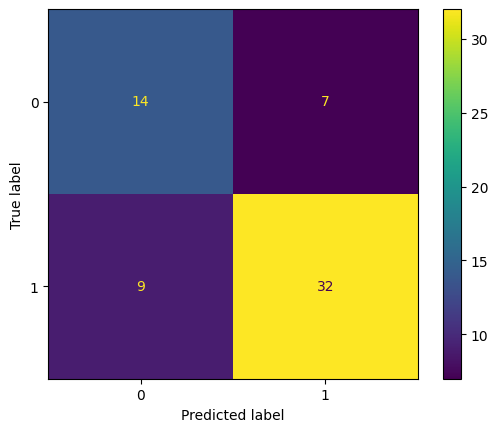

In [126]:
# Confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_trues_val, y_labels_val, labels=np.arange(2)),
                                display_labels=np.arange(2))
fig = disp.plot(ax=None).figure_
plt.show()

In [127]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Validação
acc = accuracy_score(y_trues_val, y_labels_val)
prec = precision_score(y_trues_val, y_labels_val)
rec = recall_score(y_trues_val, y_labels_val)
f1 = f1_score(y_trues_val, y_labels_val)

# Imprimindo as métricas
print('Acurácia: %.2f' % acc)
print('Precisão: %.2f' % prec)
print('Recall: %.2f' % rec)
print('F1-Score: %.2f' % f1)

Acurácia: 0.74
Precisão: 0.82
Recall: 0.78
F1-Score: 0.80


Em comparação com os modelos anteriores este modelo performou com pouca melhora e dobrou o tempo de treinamento. Por isso não usarei o resnet50 no próximo experimento.

# Modelo 4

 Como ainda não consegui um valor de acurácia satisfatório, farei um último teste, seguindo com o resnet18, utilizando as imagens sem o crop de moldura preta feita no início. Será feito somente as transformações e resize antes de entrar na rede, que será novamente a resnet18 por ser mais rápida.


In [28]:
import torchvision.transforms as transforms
import torchvision.datasets as datasets
from torch.utils.data import DataLoader

In [29]:
# the training transforms
train_transform_4 = transforms.Compose([
    transforms.Resize((224,224)),                     # A maioria dos artigos recomenda imagens 224x224 para Resnet
    transforms.Grayscale(),
    transforms.RandomHorizontalFlip(),                # Data augmentation no conjunto de treino
    transforms.RandomVerticalFlip(),
    transforms.ToTensor(),
    transforms.Normalize([0.5, ], [0.5, ]),           # Normalization helps get data within a range and reduces the skewness which helps learn faster and better
])

# the validation transforms
valid_transform_4 = transforms.Compose([
    transforms.Resize((224,224)),
    transforms.Grayscale(),
    transforms.ToTensor(),
    transforms.Normalize([0.5, ], [0.5, ]),
])

In [30]:
path = f"gdrive/MyDrive/{pasta_compartilhada}/Dados/Ex06/"

# training dataset
train_dataset_4 = datasets.ImageFolder(
    root=path+'Brain_Tumor_Dataset/train',
    transform=train_transform_4
)
# validation dataset
valid_dataset_4 = datasets.ImageFolder(
    root=path+'Brain_Tumor_Dataset/val',
    transform=valid_transform_4
)

# checando informações
print('############################################ TRAIN ############################################')
print(train_dataset_4) # 90 tumor, 53 health
print()
print('############################################ VAL ############################################')
print(valid_dataset_4) # 41 tumor, 21 health

############################################ TRAIN ############################################
Dataset ImageFolder
    Number of datapoints: 143
    Root location: gdrive/MyDrive/P_IA905A_2024S1/Dados/Ex06/Brain_Tumor_Dataset/train
    StandardTransform
Transform: Compose(
               Resize(size=(224, 224), interpolation=bilinear, max_size=None, antialias=True)
               Grayscale(num_output_channels=1)
               RandomHorizontalFlip(p=0.5)
               RandomVerticalFlip(p=0.5)
               ToTensor()
               Normalize(mean=[0.5], std=[0.5])
           )

############################################ VAL ############################################
Dataset ImageFolder
    Number of datapoints: 62
    Root location: gdrive/MyDrive/P_IA905A_2024S1/Dados/Ex06/Brain_Tumor_Dataset/val
    StandardTransform
Transform: Compose(
               Resize(size=(224, 224), interpolation=bilinear, max_size=None, antialias=True)
               Grayscale(num_output_channels=1)

2
<class 'torch.Tensor'> <class 'int'>
Shape da imagem: torch.Size([1, 224, 224])
Label: 1
Maior valor de intensidade da imagem: tensor(0.8275)
Menor valor de intensidade da imagem: tensor(-1.)


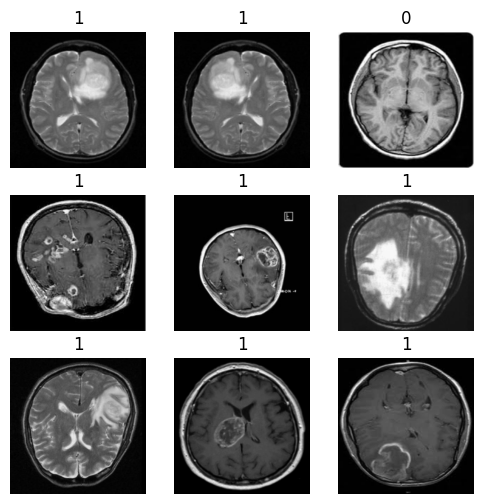

In [31]:
# Checando informações de uma amostra de treinamento
training_example = random.choice(train_dataset_4)
print(len(training_example))
print(type(training_example[0]), type(training_example[1]))
print('Shape da imagem:', training_example[0].shape)
print('Label:', training_example[1])
print('Maior valor de intensidade da imagem:', torch.max(training_example[0]))
print('Menor valor de intensidade da imagem:', torch.min(training_example[0]))

# Visualizando algumas imagens e labels do conjunto de treinamento
figure = plt.figure(figsize=(6, 6))
cols, rows = 3, 3
for i in range(1, cols * rows + 1):
    img, label = random.choice(train_dataset_4)
    plt.subplot(rows, cols, i)
    plt.title(label)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray", vmin=-1, vmax=1)
plt.show()

In [63]:
hparams = {"experiment_name": "Exp_ResNet_4",  # experiment name identifies the run for later
           "max_epochs": 100,  # number of epochs to train
           "batch_size": 25,  # size of batch
           "nworkers": mp.cpu_count(),  # number of workers to use in parallel loading
           "nout": 2,  # number of classes
           "nin": 1,  # number of channels of the input image
           "lr": 1e-4,  # learning rate
           "wd": 1e-5,  # weight decay for optimizer
           "cpu": False,  # forces using the CPU
           }

for k, v in hparams.items():
    print(f"{k}: {v}")

experiment_name: Exp_ResNet_4
max_epochs: 100
batch_size: 25
nworkers: 2
nout: 2
nin: 1
lr: 0.0001
wd: 1e-05
cpu: False


In [64]:
# train_dataset_4[0]

In [65]:
class MNISTDataModule(pl.LightningDataModule):
    def __init__(self, hparams):
        super().__init__()
        self.save_hyperparameters(hparams)

    def setup(self, stage=None):
        self.train = train_dataset_4
        self.val = valid_dataset_4

    '''
    Dataloaders optimize data loading and automatically prepare batches
    '''
    def train_dataloader(self):
        return DataLoader(self.train, batch_size=self.hparams.batch_size, num_workers=self.hparams.nworkers, shuffle=True)

    def val_dataloader(self):
        return DataLoader(self.val, batch_size=self.hparams.batch_size, num_workers=self.hparams.nworkers, shuffle=False)

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Shape do batch: torch.Size([25, 1, 224, 224])


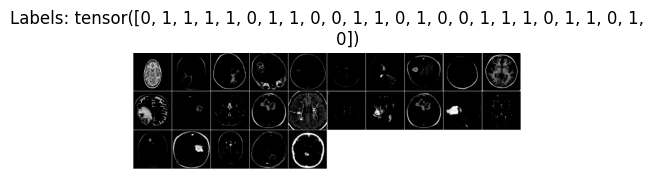

In [66]:
# DEBUG DATA MODULE
data_module = MNISTDataModule(hparams)
data_module.setup()

dataloader_4 = data_module.train_dataloader()
img_batch, label_batch = next(iter(dataloader_4))
print("Shape do batch:", img_batch.shape)

img_grid = make_grid(img_batch, nrow=5, pad_value=1)
fig = plt.figure(figsize=(5,5))
plt.imshow(img_grid.permute(1, 2, 0).numpy(), vmin=-1, vmax=1) # Aqui não está plotando no range [-1, 1]
plt.title(f'Labels: {label_batch}')
plt.axis('off')
plt.show()

In [67]:
# Definindo a CNN - Resnet18

cnn_model = models.resnet18(weights=None)
# print(cnn_model)

In [68]:
# Adaptando primeira e última camada para se adequar aos meus dados de entrada e saída

cnn_model.conv1 = nn.Conv2d(hparams['nin'], 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
num_ftrs = cnn_model.fc.in_features
cnn_model.fc = nn.Linear(num_ftrs, hparams['nout'])
# print(cnn_model)

In [69]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)
cnn_model.to(device)
summary(cnn_model, (1, 224, 224)) # mesmo modelo do experimento 1, dados diferentes

cpu
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           3,136
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]          36,864
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
             ReLU-10           [-1, 64, 56, 56]               0
       BasicBlock-11           [-1, 64, 56, 56]               0
           Conv2d-12           [-1, 64, 56, 56]          36,864
      BatchNorm2d-13           [-1, 64, 56, 56]             128
             ReLU-14           [-1,

In [70]:
class TrainMNIST(pl.LightningModule):
    def __init__(self, hparams):
        super().__init__()

        self.save_hyperparameters(hparams)
        self.model = cnn_model
        self.loss = nn.CrossEntropyLoss()
        self.accuracy = Accuracy(task="binary", num_classes=self.hparams.nout)

        torchinfo.summary(self.model)

    def forward(self, x):
        return self.model(x).softmax(dim=-1)

    def classification_step(self, mode, batch):
        x, y = batch
        y_hat = self.forward(x)
        loss = self.loss(y_hat, y)

        if mode == "train":
            self.log("loss", loss, on_epoch=True, on_step=True)
            return loss
        elif mode == "val":
            _, preds = torch.max(y_hat, 1)
            self.accuracy(preds, y)
            self.log("val_loss", loss, on_epoch=True, on_step=False, prog_bar=True)
            self.log("val_acc", self.accuracy, on_epoch=True, on_step=False, prog_bar=True)

    def training_step(self, train_batch, batch_idx):
        return self.classification_step("train", train_batch)

    def validation_step(self, val_batch, batch_idx):
        self.classification_step("val", val_batch)

    def configure_optimizers(self):
        optimizer = AdamW(self.model.parameters(), lr=self.hparams.lr, weight_decay=self.hparams.wd)

        return optimizer

In [71]:
debug = False  # Turn this True to test the code with a quick run

# Initialization
model = TrainMNIST(hparams)
data = MNISTDataModule(hparams)

# The PL trainer can run various callbacks during training. Here we only use the
# callback that saves the weights of the trained network.
os.makedirs("logs", exist_ok=True)
checkpoint_callback = [ModelCheckpoint(dirpath="logs",  # path to save checkpoint
                                       filename=hparams["experiment_name"] + "-{epoch}-{val_acc:.2f}",
                                       monitor="val_acc",
                                       mode="max")]

trainer = pl.Trainer(max_epochs=hparams["max_epochs"],
                     fast_dev_run=debug,
                     callbacks=checkpoint_callback,
                     log_every_n_steps=1
                     )

print("Hyperparameters:\n")
for k, v in hparams.items():
    print(f'{k}: {v}')

trainer.fit(model, data)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:653: Checkpoint directory /content/logs exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name     | Type             | Params
----------------------------------------------
0 | model    | ResNet           | 11.2 M
1 | loss     | CrossEntropyLoss | 0     
2 | accuracy | BinaryAccuracy   | 0     
----------------------------------------------
11.2 M    Trainable params
0         Non-trainable params
11.2 M    Total params
44.685    Total estimated model params size (MB)


Hyperparameters:

experiment_name: Exp_ResNet_4
max_epochs: 100
batch_size: 25
nworkers: 2
nout: 2
nin: 1
lr: 0.0001
wd: 1e-05
cpu: False


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=100` reached.


In [72]:
path = f"lightning_logs"
%tensorboard --logdir {path}

Reusing TensorBoard on port 6006 (pid 13354), started 1:41:37 ago. (Use '!kill 13354' to kill it.)

<IPython.core.display.Javascript object>

In [76]:
# Escolhendo o callback com maior acurácia para mostrar os resultados

baseline_model = f"/content/logs/Exp_ResNet_4-epoch=58-val_acc=0.89.ckpt"
print(f"Using model {baseline_model}")

# Load trained model
model = TrainMNIST.load_from_checkpoint(baseline_model).eval()

# Initialize validation data
data = MNISTDataModule(hparams)
data.setup()
data.hparams.batch_size = 1
val_data = data.val_dataloader()

def collect_2d_results(data, model):
    y_trues = []
    y_labels = []
    for (img, label) in data:
        with torch.no_grad():
            out = model(img).argmax(dim=-1).item()

        label = label.numpy()
        y_trues.append(label)
        y_labels.append(out)

    return y_trues, y_labels

y_trues_val, y_labels_val = collect_2d_results(val_data, model)

Using model /content/logs/Exp_ResNet_4-epoch=58-val_acc=0.89.ckpt


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


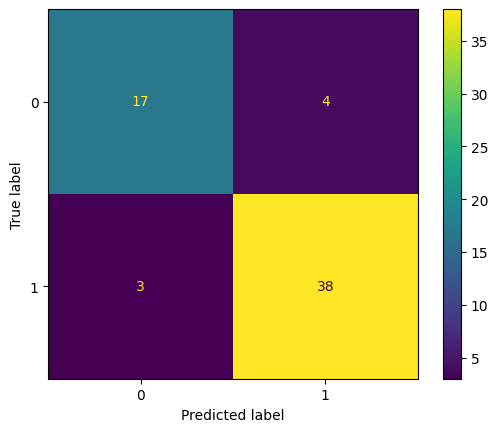

In [77]:
# Confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_trues_val, y_labels_val, labels=np.arange(2)),
                                display_labels=np.arange(2))
fig = disp.plot(ax=None).figure_
plt.show()

In [78]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Validação
acc = accuracy_score(y_trues_val, y_labels_val)
prec = precision_score(y_trues_val, y_labels_val)
rec = recall_score(y_trues_val, y_labels_val)
f1 = f1_score(y_trues_val, y_labels_val)

# Imprimindo as métricas
print('Acurácia: %.2f' % acc)
print('Precisão: %.2f' % prec)
print('Recall: %.2f' % rec)
print('F1-Score: %.2f' % f1)

Acurácia: 0.89
Precisão: 0.90
Recall: 0.93
F1-Score: 0.92


O modelo teve um comportamento muito parecido com o modelo 1, realizei mais algumas modificações de parâmetros para tentar melhorar acurácia.





**hiperparametros:**

- experiment_name: Exp_ResNet_4
- max_epochs: 10
- batch_size: 50
- nworkers: 2
- nout: 2
- nin: 1
- lr: 0.0001
- wd: 1e-05
- cpu: False

**resultados:**
Acurácia: 0.71
Precisão: 0.71
Recall: 0.95
F1-Score: 0.81

**hiperparametros:**

- experiment_name: Exp_ResNet_4
- max_epochs: 10
- batch_size: 25
- nworkers: 2
- nout: 2
- nin: 1
- lr: 0.0001
- wd: 1e-05
- cpu: False

**resultados:**
Acurácia: 0.73
Precisão: 0.73
Recall: 0.93
F1-Score: 0.82

**hiperparametros:**

- experiment_name: Exp_ResNet_4
- max_epochs: 100
- batch_size: 25
- nworkers: 2
- nout: 2
- nin: 1
- lr: 0.0001
- wd: 1e-05
- cpu: False

**resultados:**


Este último teste foi o que obtive melhor resultado, diminuindo tamanho do batch e aumentando as épocas. O melhor resultado ocorreu na época 58. Usarei este modelo com os dados de Teste a seguir.

# Teste

Para os dados de teste farei o mesmo tratamento feito com os dados de validação.

In [84]:
path = f"gdrive/MyDrive/{pasta_compartilhada}/Dados/Ex06/"

# test dataset
test_dataset = datasets.ImageFolder(
    root=path+'Brain_Tumor_Dataset/test',
    transform=valid_transform_4
)

# checando informações
print('############################################ TEST ############################################')
print(test_dataset) # 48 IMGS


############################################ TEST ############################################
Dataset ImageFolder
    Number of datapoints: 48
    Root location: gdrive/MyDrive/P_IA905A_2024S1/Dados/Ex06/Brain_Tumor_Dataset/test
    StandardTransform
Transform: Compose(
               Resize(size=(224, 224), interpolation=bilinear, max_size=None, antialias=True)
               Grayscale(num_output_channels=1)
               ToTensor()
               Normalize(mean=[0.5], std=[0.5])
           )


In [82]:
test_dataset[0] # ele colocou todos com label 0, mas não temos as labels

(tensor([[[-0.9451, -0.9451, -0.9451,  ..., -0.9451, -0.9451, -0.9451],
          [-0.9451, -0.9451, -0.9451,  ..., -0.9451, -0.9451, -0.9451],
          [-0.9451, -0.9451, -0.9451,  ..., -0.9451, -0.9451, -0.9451],
          ...,
          [-0.9451, -0.9451, -0.9451,  ..., -0.9608, -0.9608, -0.9608],
          [-0.9451, -0.9451, -0.9451,  ..., -0.9608, -0.9608, -0.9608],
          [-0.9451, -0.9451, -0.9451,  ..., -0.9608, -0.9608, -0.9608]]]),
 0)

2
<class 'torch.Tensor'> <class 'int'>
Shape da imagem: torch.Size([1, 224, 224])
Label: 0
Maior valor de intensidade da imagem: tensor(1.)
Menor valor de intensidade da imagem: tensor(-1.)


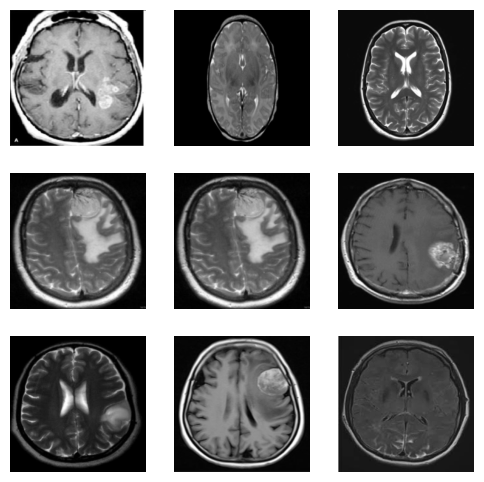

In [87]:
# Checando informações de uma amostra de teste
test_example = random.choice(test_dataset)
print(len(test_example))
print(type(test_example[0]), type(test_example[1]))
print('Shape da imagem:', test_example[0].shape)
print('Label:', test_example[1])
print('Maior valor de intensidade da imagem:', torch.max(test_example[0]))
print('Menor valor de intensidade da imagem:', torch.min(test_example[0]))

# Visualizando algumas imagens de teste
figure = plt.figure(figsize=(6, 6))
cols, rows = 3, 3
for i in range(1, cols * rows + 1):
    img, label = random.choice(test_dataset)
    plt.subplot(rows, cols, i)
    # plt.title(label)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray", vmin=-1, vmax=1)
plt.show()

In [97]:
# Escolhendo o modelo com melhor Acc: Exp_ResNet_4-epoch=58-val_acc=0.89

baseline_model = f"/content/logs/Exp_ResNet_4-epoch=58-val_acc=0.89.ckpt"
print(f"Using model {baseline_model}")

# Load trained model
model = TrainMNIST.load_from_checkpoint(baseline_model).eval()

# Predict test
# data = MNISTDataModule(hparams)
# data.setup()
# data.hparams.batch_size = 1
# val_data = data.val_dataloader()
test_data = DataLoader(test_dataset, batch_size=1, num_workers=mp.cpu_count(), shuffle=False)

y_preds = []
for (img, label) in test_data:
    with torch.no_grad():
        out = model(img).argmax(dim=-1).item()
    y_preds.append(out)

Using model /content/logs/Exp_ResNet_4-epoch=58-val_acc=0.89.ckpt


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


In [99]:
# y_preds

In [117]:
test_img_label = []
y_labels = []
for i in range(len(test_dataset)):
  path = os.path.splitext(os.path.basename(os.path.normpath(test_dataset.imgs[i][0])))[0]

  # criando array para plotagem
  test_img_label.append((test_dataset[i][0],y_preds[i]))

  # criando array para salvar em txt
  if y_preds[i] == 0: y_labels.append(path+' health')
  if y_preds[i] == 1: y_labels.append(path+' tumor')


In [118]:
test_img_label[0]

(tensor([[[-0.9451, -0.9451, -0.9451,  ..., -0.9451, -0.9451, -0.9451],
          [-0.9451, -0.9451, -0.9451,  ..., -0.9451, -0.9451, -0.9451],
          [-0.9451, -0.9451, -0.9451,  ..., -0.9451, -0.9451, -0.9451],
          ...,
          [-0.9451, -0.9451, -0.9451,  ..., -0.9608, -0.9608, -0.9608],
          [-0.9451, -0.9451, -0.9451,  ..., -0.9608, -0.9608, -0.9608],
          [-0.9451, -0.9451, -0.9451,  ..., -0.9608, -0.9608, -0.9608]]]),
 1)

48


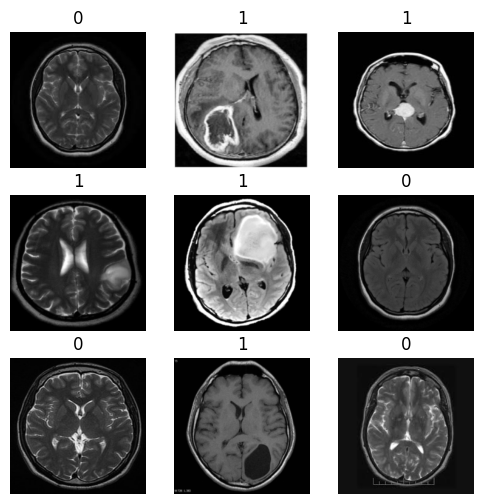

In [124]:
# Checando o resultado do teste
print(len(test_img_label))

# Visualizando algumas imagens e labels preditas
figure = plt.figure(figsize=(6, 6))
cols, rows = 3, 3
for i in range(1, cols * rows + 1):
    img, label = test_img_label[i]
    plt.subplot(rows, cols, i)
    plt.title(label)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray", vmin=-1, vmax=1)
plt.show()

Aparentemente o modelo está acertando alguns ✌

In [125]:
with open('Ex06_261300.txt', 'w') as file:

  file.writelines("% s\n" % line for line in y_labels)